In [ ]:
import pandas as pd
import os
import requests
import cv2
import numpy as np
from tqdm import tqdm
import re

# Importar necesarios modulos
from src.feature_extraction import FeatureExtractor
from src.dimensionality_reduction import apply_pca, apply_svd
from src.clustering import cluster_kmeans, cluster_agglomerative
from src.visualize_representatives import show_multiple_per_cluster
from src.recommendation import recommend_similar
from src.visualize_representatives import show_recommendations
from src.evaluation import evaluate_genre_consistency, evaluate_internal_metrics, plot_tsne, plot_genre_distribution_heatmap


- funcion axuliar para cargar data ya guardada y evitar pre procesamiento de la Seccion 1


In [9]:

def load_data(features_path, metadata_path, labels_path = None):
    features = np.load(features_path)
    metadata = pd.read_csv(metadata_path)
    if labels_path is not None:
        labels = np.load(labels_path)
        metadata["cluster"] = labels
    return features, metadata

In [ ]:
features, metadata = load_data(
    "features.npy",
    "movies_with_posters.csv"
)

# Sección 01: Adquisición de datos
 - En esta sección se carga y unifica los datos de MovieLens y los enlaces a pósters.

In [ ]:
movies_df = pd.read_csv('data/movielens/movies.csv')
links_df = pd.read_csv('data/movielens/links.csv')
genre_df = pd.read_csv('data/movielens/MovieGenre.csv', encoding='latin1')
# Limpiar nombres de columnas por si hay espacios
movies_df.columns = movies_df.columns.str.strip()
links_df.columns = links_df.columns.str.strip()
genre_df.columns = genre_df.columns.str.strip()

# Merge movies con links por 'movieId'
movies_links_df = pd.merge(movies_df, links_df, on='movieId', how='inner')

# Merge con MovieGenre.csv (por imdbId)
full_df = pd.merge(movies_links_df, genre_df, on='imdbId', how='inner')

# Filtrar las filas que tienen Poster no vacío o no nulo
full_df = full_df[full_df['Poster'].notna() & (full_df['Poster'].str.strip() != '')]

columns = ['movieId', 'title', 'genres', 'imdbId', 'Imdb', 'Poster']
columns = [col for col in columns if col in full_df.columns]  # solo columnas que existen

final_df = full_df[columns]
print(f"Final DataFrame shape: {final_df.shape}")
final_df = final_df[final_df['title'].str.contains(r'\(\d{4}\)', regex=True)]
print(f"Final DataFrame con unicamente peliculas con año: {final_df.shape}")




Final DataFrame shape: (36812, 5)
Final DataFrame shape after filtering titles: (36708, 5)


- Descargar los poster en local y guardar la data que tiene poster descargado

In [11]:
def download_and_save_image(url, path):
    try:
        response = requests.get(url, timeout=5)
        if response.status_code == 200 and 'image' in response.headers.get('Content-Type', ''):
            img_array = np.frombuffer(response.content, np.uint8)
            img = cv2.imdecode(img_array, cv2.IMREAD_COLOR)
            if img is not None:
                cv2.imwrite(path, img)  # Guarda usando OpenCV
                return True
    except Exception:
        pass
    return False

POSTER_DIR = 'data/posters'
OUTPUT_CSV = 'movies_with_posters.csv'
FAILED_CSV = 'failed_posters.csv'
os.makedirs(POSTER_DIR, exist_ok=True)

downloaded_rows = []
failed_rows = []

print("Descargando posters (se omiten los que ya existen)...")

for _, row in tqdm(final_df.iterrows(), total=len(final_df)):
    poster_url = str(row['Poster']).strip()
    movie_id = row['movieId']
    save_path = os.path.join(POSTER_DIR, f"{movie_id}.jpg")
    
    if os.path.exists(save_path):
        downloaded_rows.append(row)
        continue
    
    if download_and_save_image(poster_url, save_path):
        downloaded_rows.append(row)
    else:
        failed_rows.append(row)

pd.DataFrame(downloaded_rows).to_csv(OUTPUT_CSV, index=False)
if failed_rows:
    pd.DataFrame(failed_rows).to_csv(FAILED_CSV, index=False)

print(f"\nPosters válidos: {len(downloaded_rows)}")
print(f"CSV creado: {OUTPUT_CSV}")
if failed_rows:
    print(f"Fallidos: {len(failed_rows)} (ver {FAILED_CSV})")

Descargando posters (se omiten los que ya existen)...


100%|██████████| 36708/36708 [35:07<00:00, 17.41it/s]  



Posters válidos: 27414
CSV creado: movies_with_posters.csv
Fallidos: 9294 (ver failed_posters.csv)


# Sección 02: Extracción de características visuales
Aquí se definen funciones para extraer descriptores de cada póster:
- Histogramas de color (RGB/HSV/LAB).
- Colores dominantes (Kmenas)
- Descriptores de textura (LBP, GLCM, Gabor)
- Descriptores de bordes (Canny)
- Composicion Visual
- Momentos de imagen (Hu)
- Caracterpisticas espaciales (Segmentación SLIC)

In [ ]:

extractor = FeatureExtractor()
features= extractor.extract_features_parallel(
        read_csv_path='movies_with_posters.csv',
        data_dir='data/posters'
)

Procesando 27414 imágenes con 16 procesos...


Extrayendo características: 100%|██████████| 27414/27414 [23:58<00:00, 19.05it/s]


Características extraídas: (27414, 322)
Características extraídas y guardadas.
   - Total de imágenes procesadas: 27414
   - Imágenes fallidas: 0
   - Dimensiones de características: (27414, 322)


# Sección 03: Reducción de Dimensionalidad
Se reduce la dimensionalidad de X para acelerar el clustering y eliminar ruido

Usaremos dos metodos:
- PCA (Analisis de Componentes Principales)
- SVD (Descomposicion en Valores Singulares)

In [38]:

# Aplicando PCA y SVD con un umbral de varianza del 95%
pca_features = apply_pca(features, var_threshold=0.80,)
svd_features = apply_svd(features, var_threshold=0.80)



[PCA] Componentes: 62, Varianza explicada: 0.8007
[SVD] Componentes: 62, Varianza explicada: 0.8007


# Sección 04: Clustering
Usaremos dos metodos:

- K-means
- AgglomerativeClustering
- GaussianMixture

In [39]:
labels_kmeans = cluster_kmeans(pca_features, n_clusters=10)
labels_aggl = cluster_agglomerative(pca_features, n_clusters=10)
labels_kmeans_svd = cluster_kmeans(svd_features, n_clusters=10, type_reduction='SVD')
labels_aggl_svd = cluster_agglomerative(svd_features, n_clusters=10 , type_reduction='SVD')



[KMeans] Clusters formados: 10
[Agglomerative] Clusters formados: 10
[KMeans] Clusters formados: 10
[Agglomerative] Clusters formados: 10


# Análisis Comparativo de Clustering (PCA vs. SVD)


## Resultados obtenidos con PCA

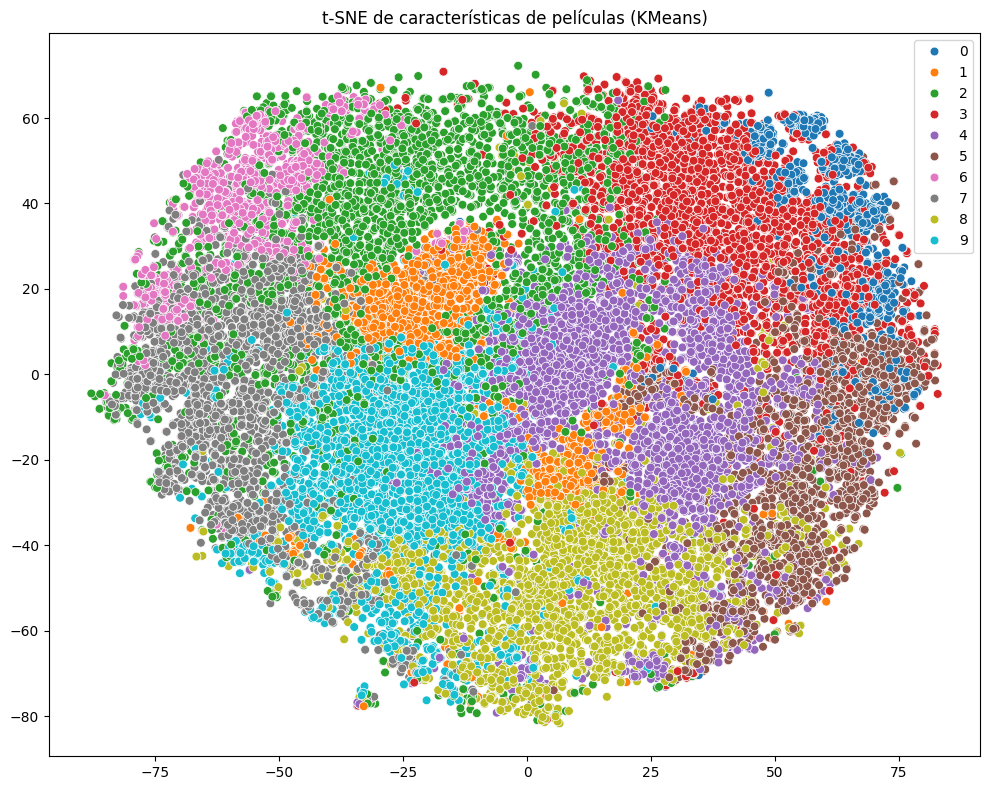

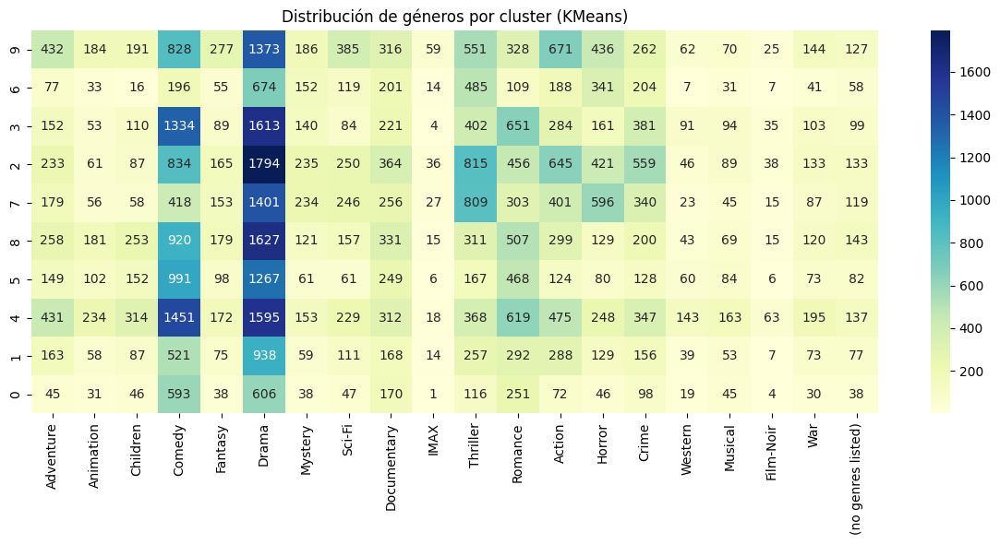

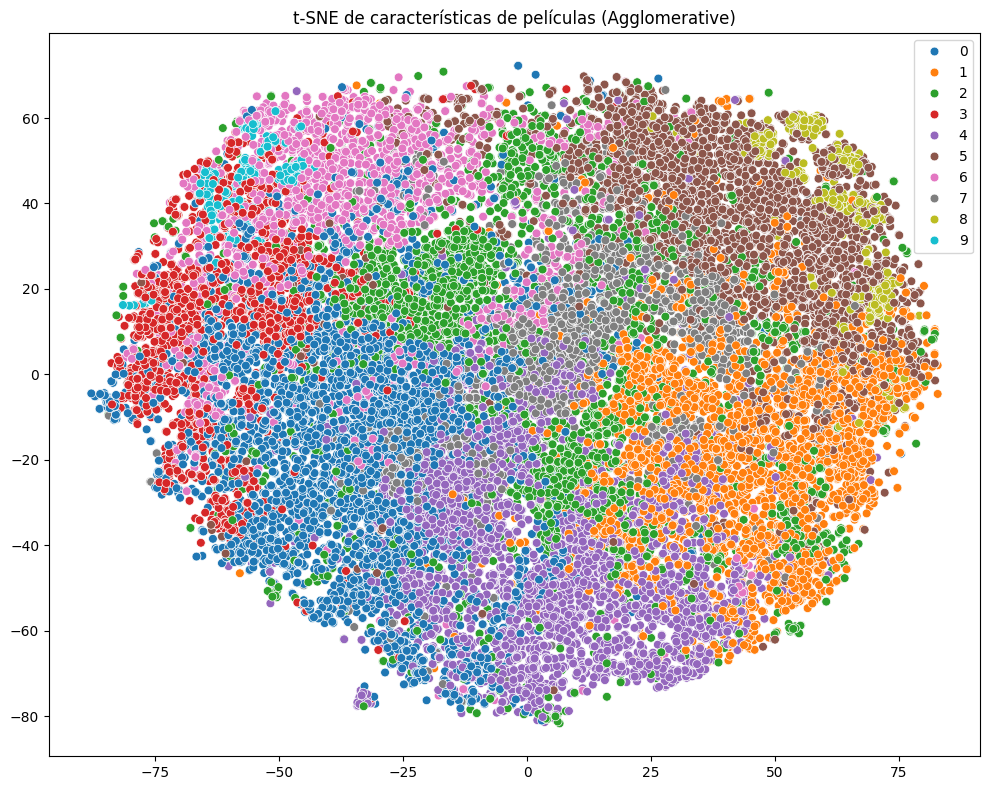

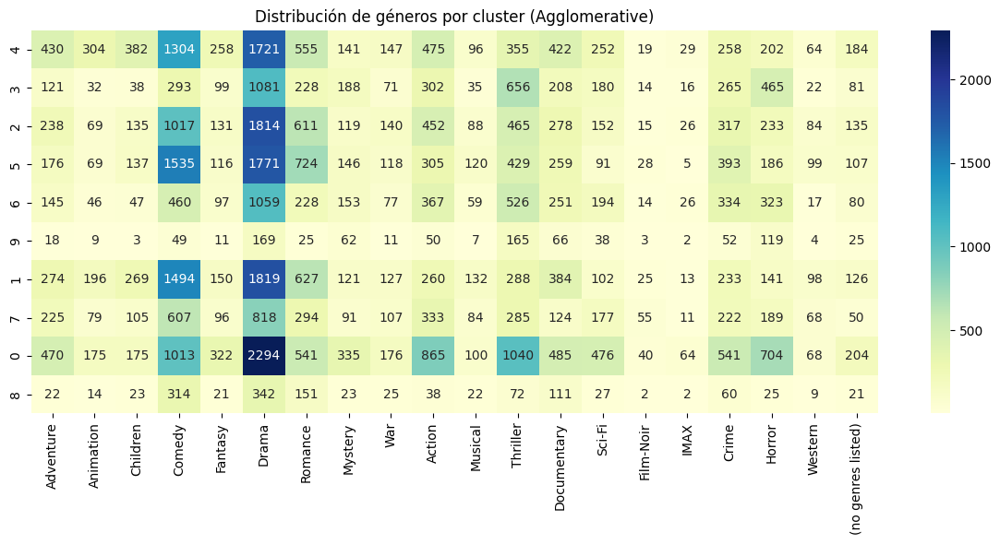

In [ ]:
# Kmeans
features, metadata = load_data(
    "features.npy",
    "movies_with_posters.csv",
    "labels_kmeans_PCA.npy"
)
plot_tsne(pca_features, metadata["cluster"].values, title="t-SNE de características de películas (KMeans)")
plot_genre_distribution_heatmap(metadata, title="Distribución de géneros por cluster (KMeans)")
# Agglomerative
features, metadata = load_data(
    "features.npy",
    "movies_with_posters.csv",
    "labels_agglomerative_PCA.npy"
)
plot_tsne(pca_features, metadata["cluster"].values, title="t-SNE de características de películas (Agglomerative)")
plot_genre_distribution_heatmap(metadata, title="Distribución de géneros por cluster (Agglomerative)")

## Resultados obtenidos con SVD

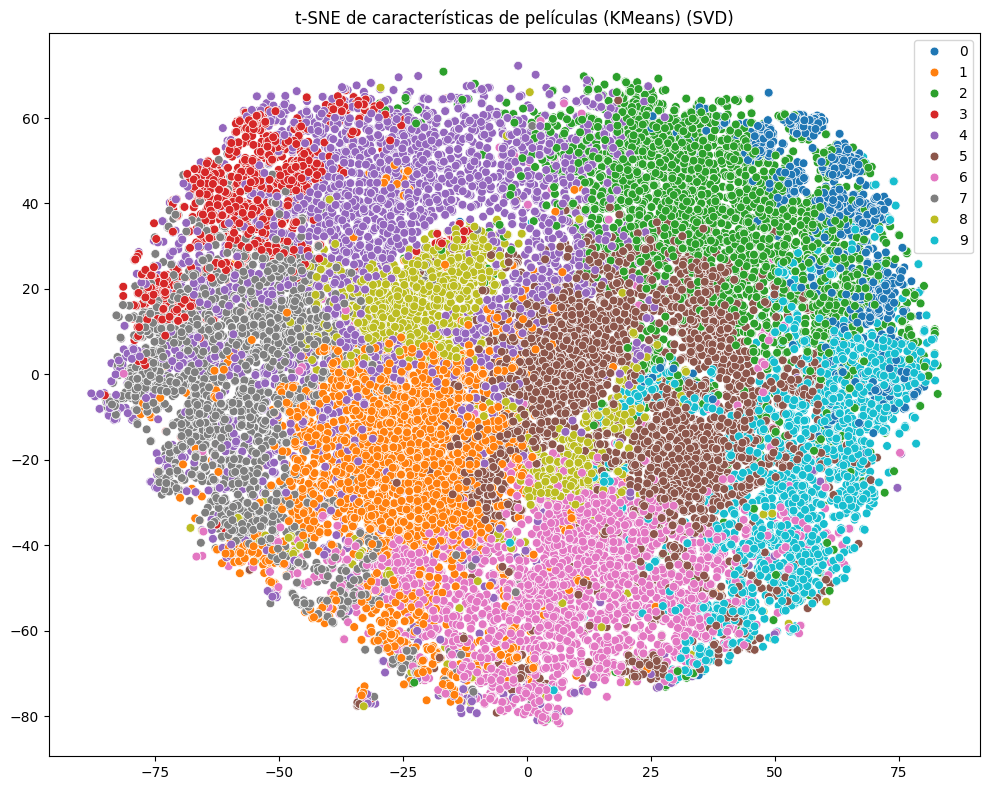

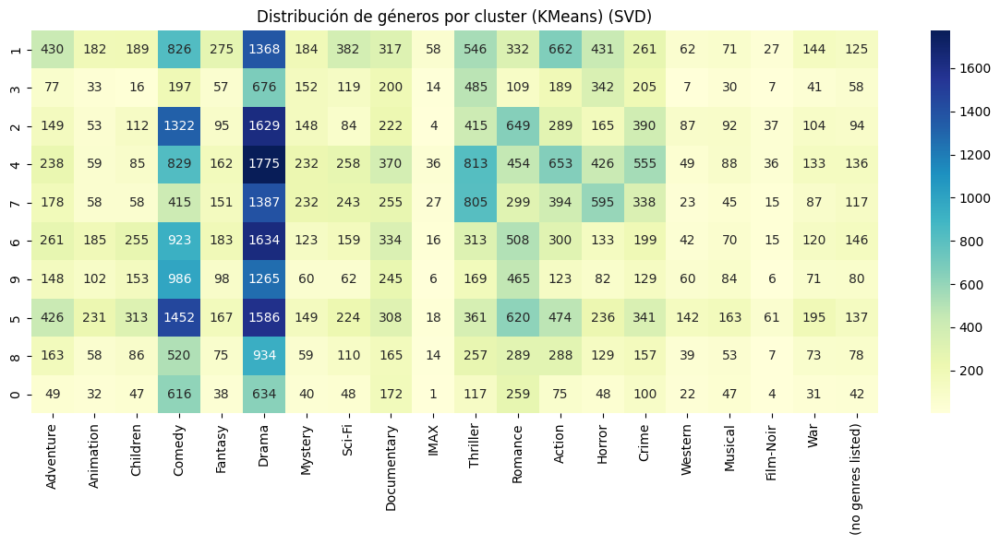

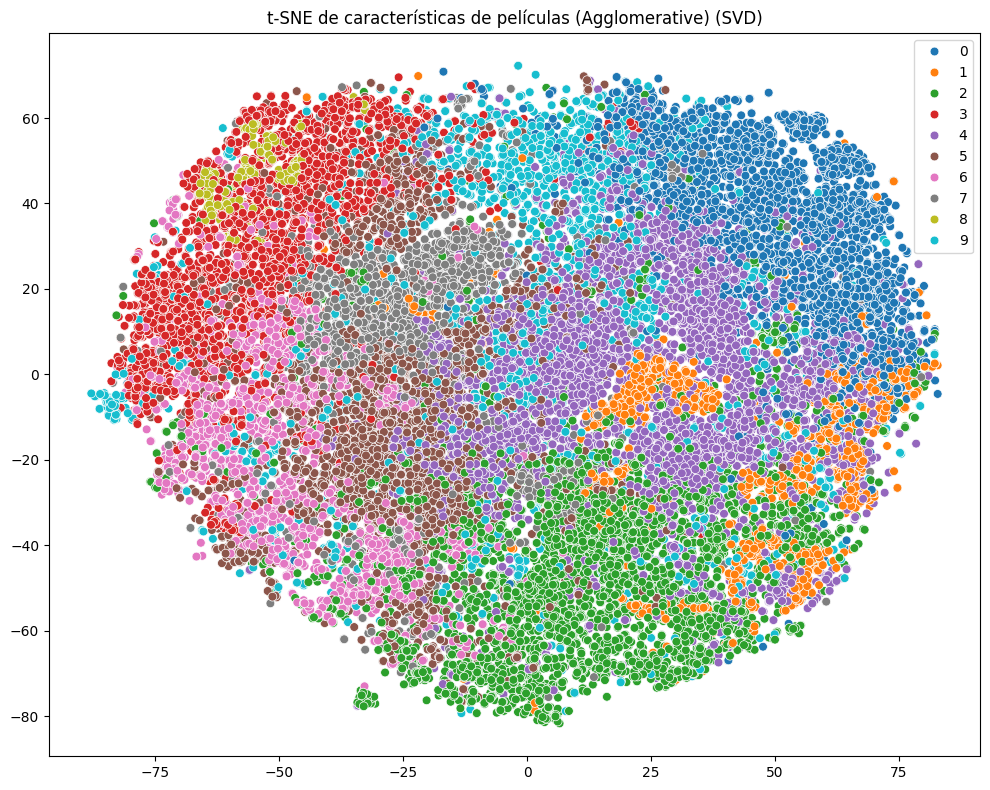

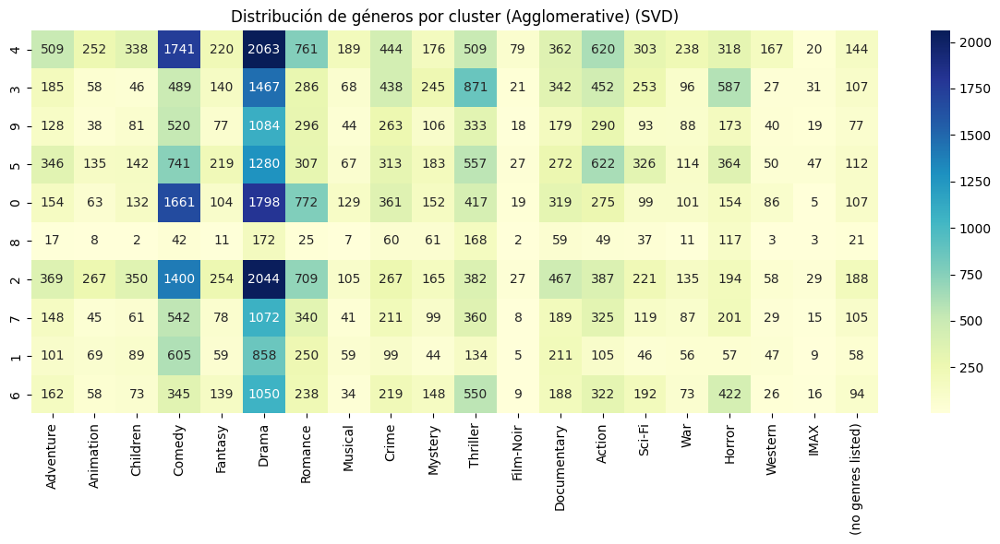

In [ ]:
# Kmeans
features, metadata = load_data(
    "features.npy",
    "movies_with_posters.csv",
    "labels_kmeans_SVD.npy"
)
plot_tsne(pca_features, metadata["cluster"].values, title="t-SNE de características de películas (KMeans) (SVD)")
plot_genre_distribution_heatmap(metadata, title="Distribución de géneros por cluster (KMeans) (SVD)")
# Agglomerative
features, metadata = load_data(
    "features.npy",
    "movies_with_posters.csv",
    "labels_agglomerative_SVD.npy"
)
plot_tsne(pca_features, metadata["cluster"].values, title="t-SNE de características de películas (Agglomerative) (SVD)")
plot_genre_distribution_heatmap(metadata, title="Distribución de géneros por cluster (Agglomerative) (SVD)")

## Conclusiones
- PCA y SVD como preprocesamiento para K-Means arrojaron resultados casi idénticos, sugiriendo que ambos capturan la varianza relevante de forma muy similar para este algoritmo.
- Agglomerative Clustering mostró ser más sensible a las diferencias entre PCA y SVD, resultando en variaciones en la composición detallada de los clusters.
- Ambos algoritmos de clustering identificaron agrupaciones temáticas reconocibles (drama, comedia, etc). K-Means tendió a producir clusters con una distribución de géneros quizás un poco más balanceada o distintiva en sus combinaciones secundarias en comparación con algunos clusters muy grandes generados por Agglomerative.

# Sección 05: Visualización de resultados

## KMeans

### Usando PCA

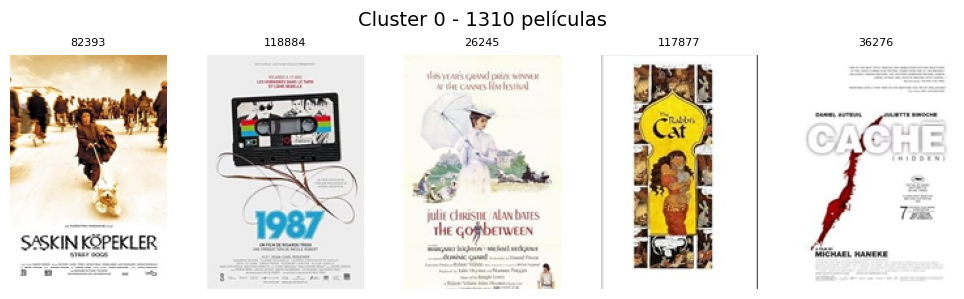

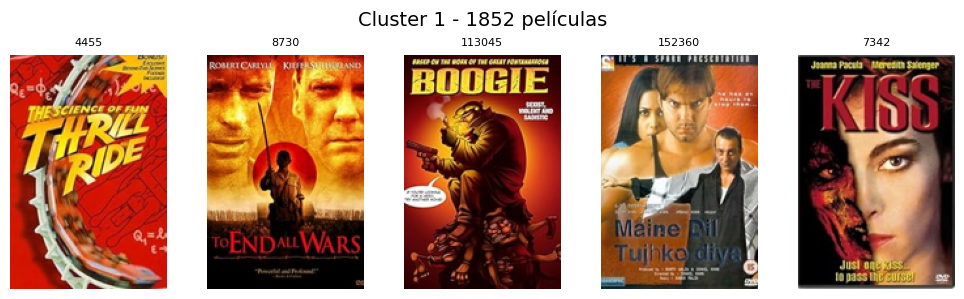

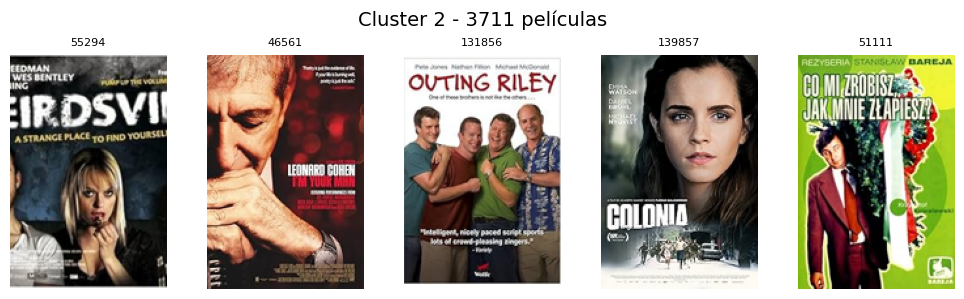

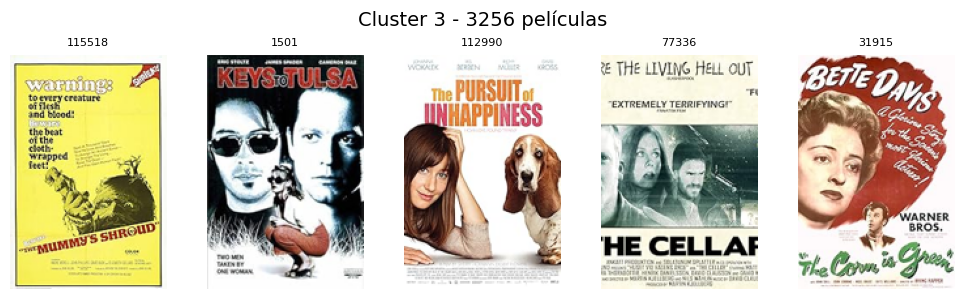

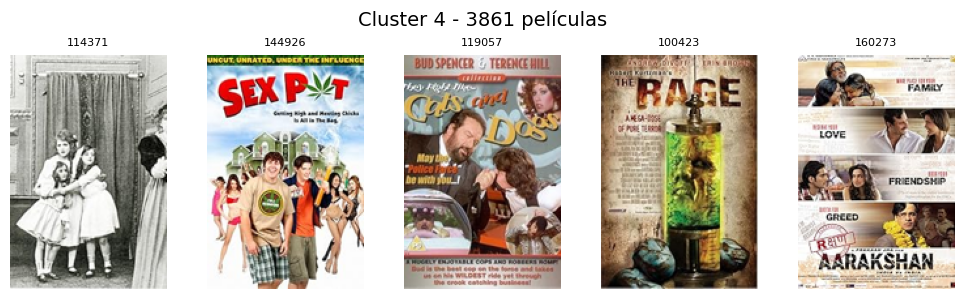

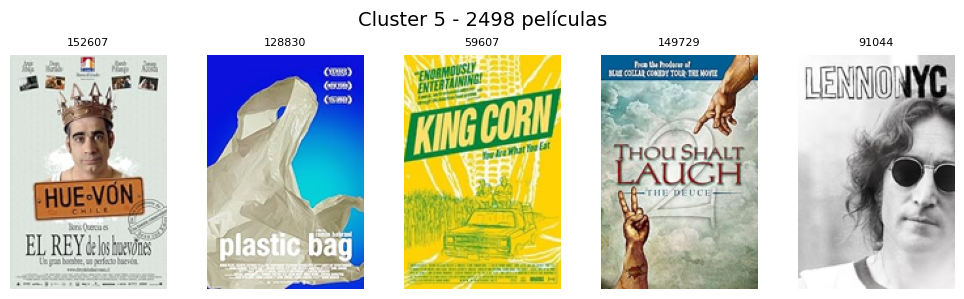

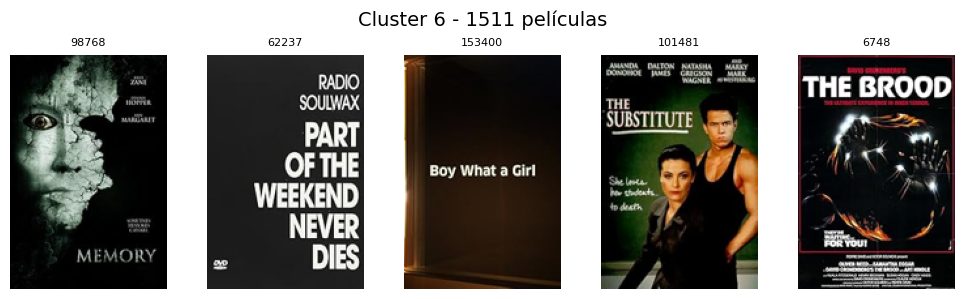

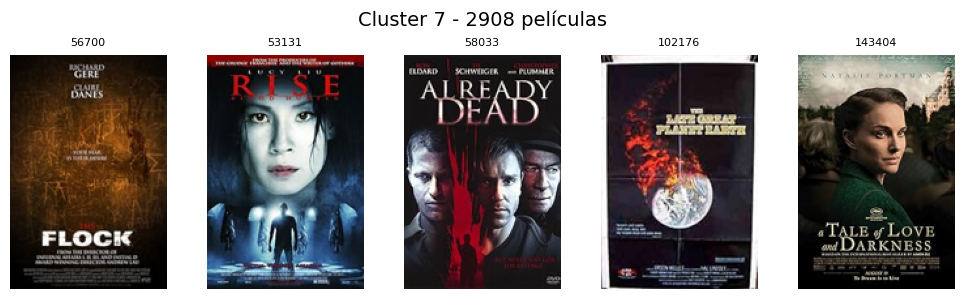

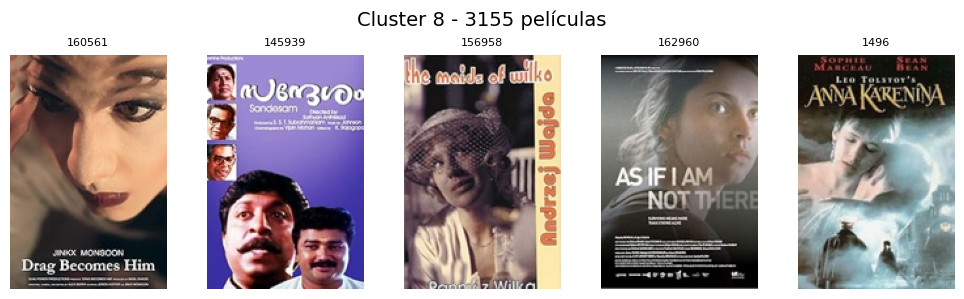

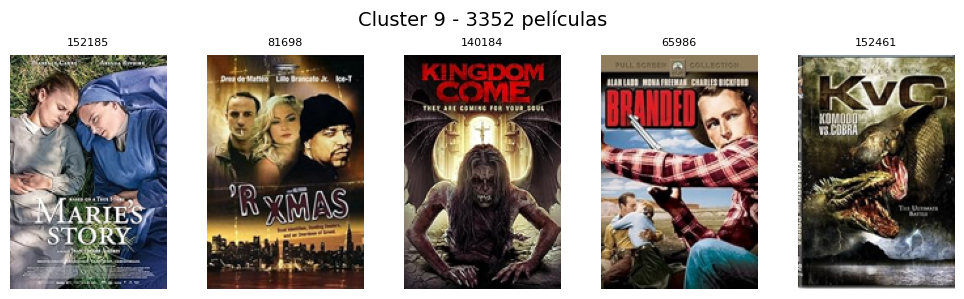

In [ ]:
features, metadata = load_data(
    "features.npy",
    "movies_with_posters.csv",
    "labels_kmeans_PCA.npy"
)
show_multiple_per_cluster(metadata, posters_dir="data/posters", max_per_cluster=5)


### Usando SVD

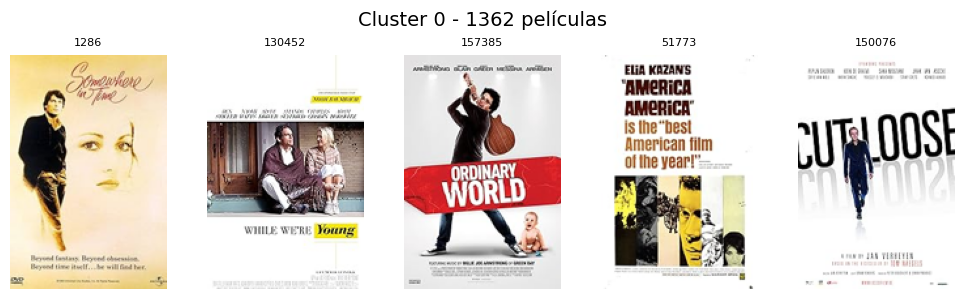

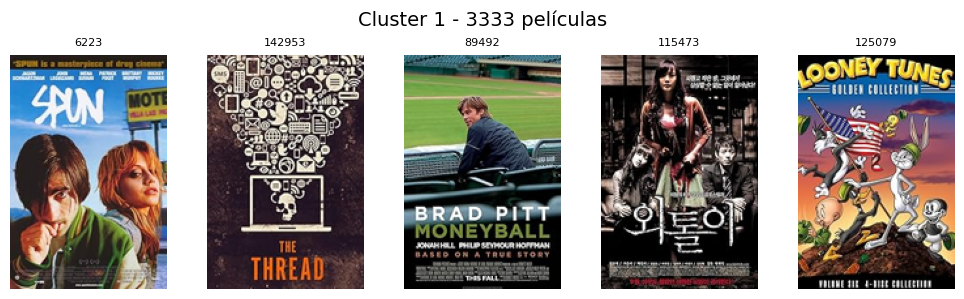

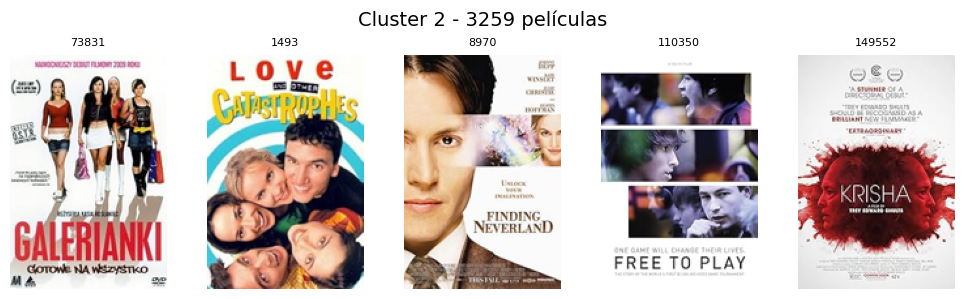

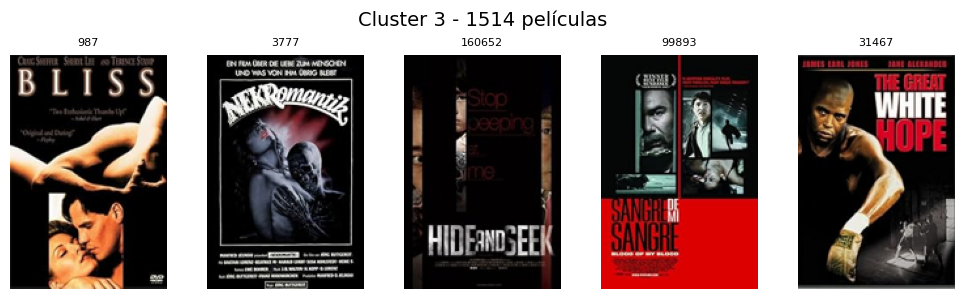

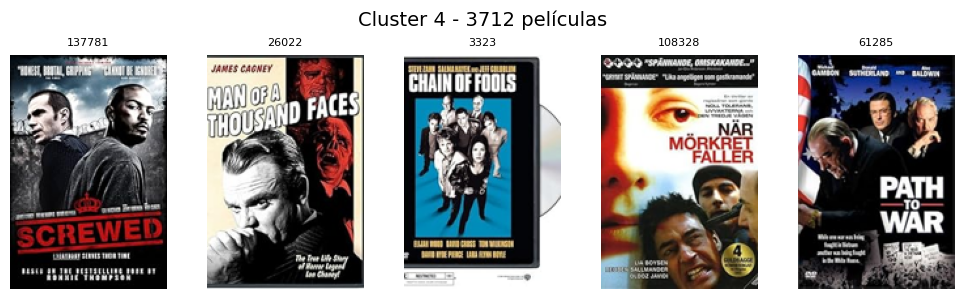

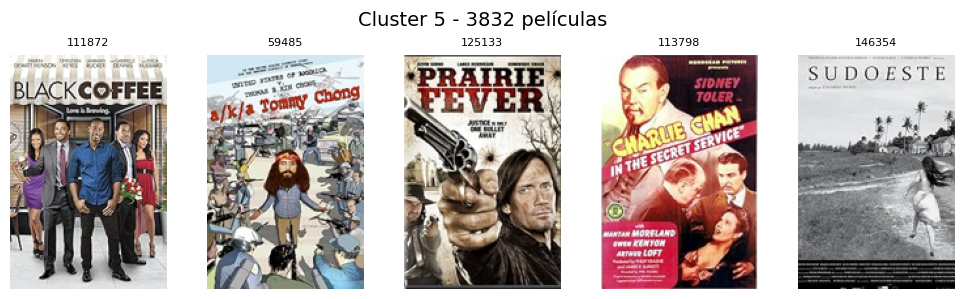

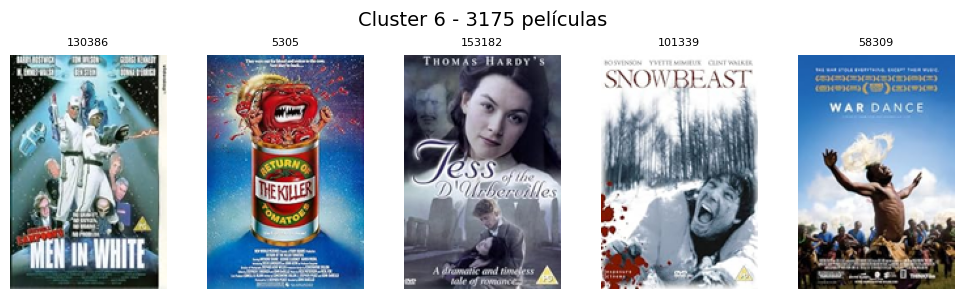

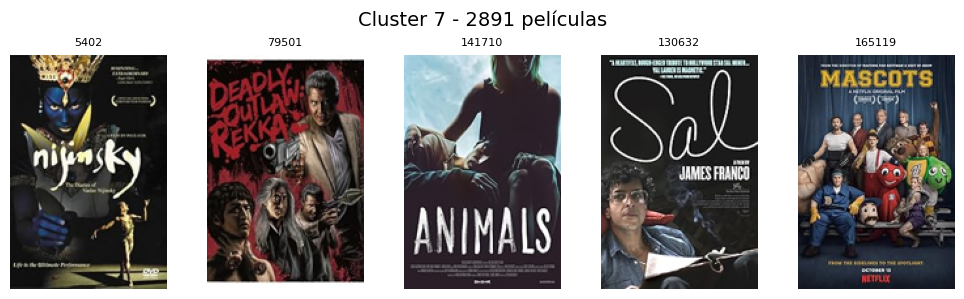

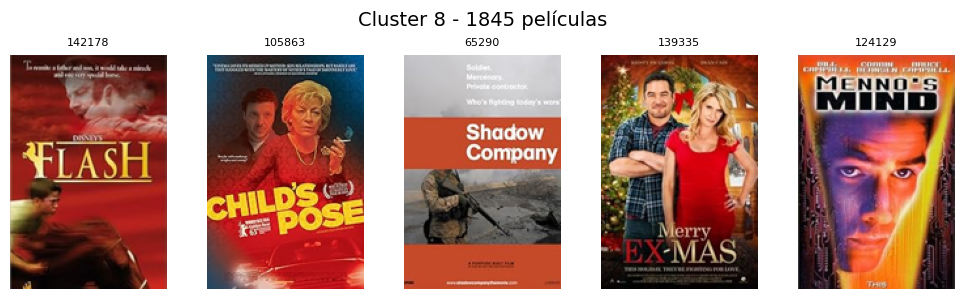

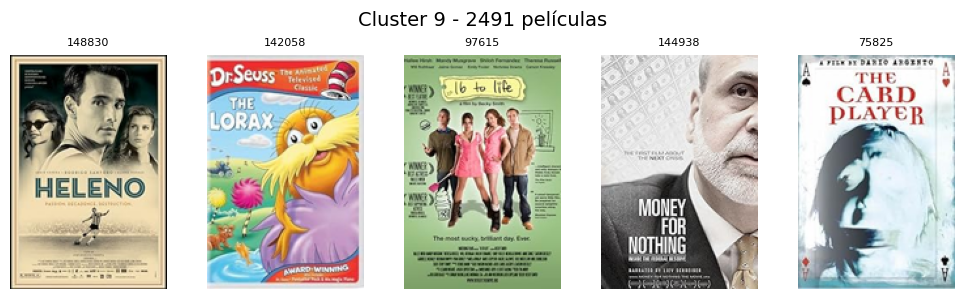

In [ ]:

features, metadata = load_data(
    "features.npy",
    "movies_with_posters.csv",
    "labels_kmeans_SVD.npy"
)
show_multiple_per_cluster(metadata, posters_dir="data/posters", max_per_cluster=5)


## Agglomerative

### Usando PCA

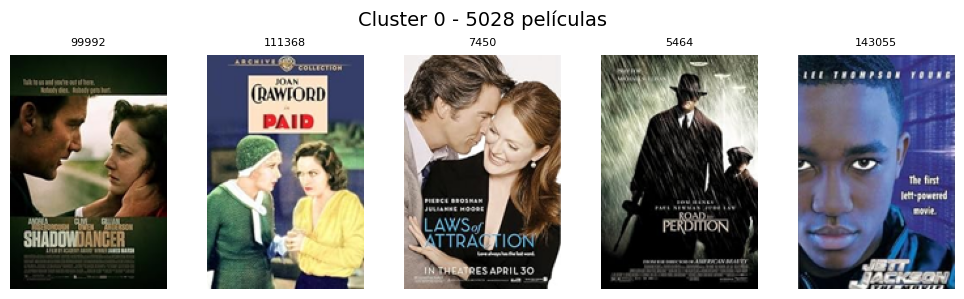

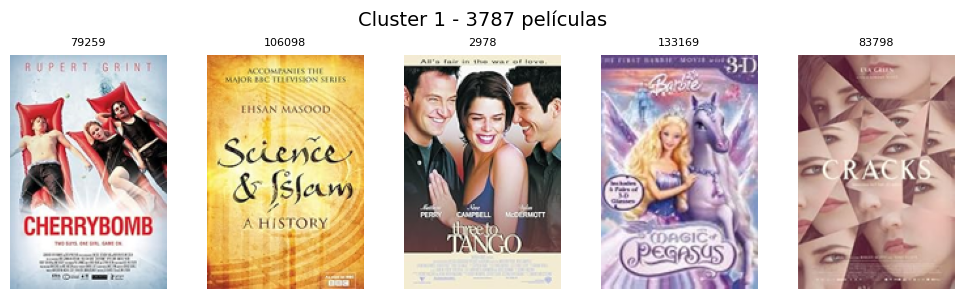

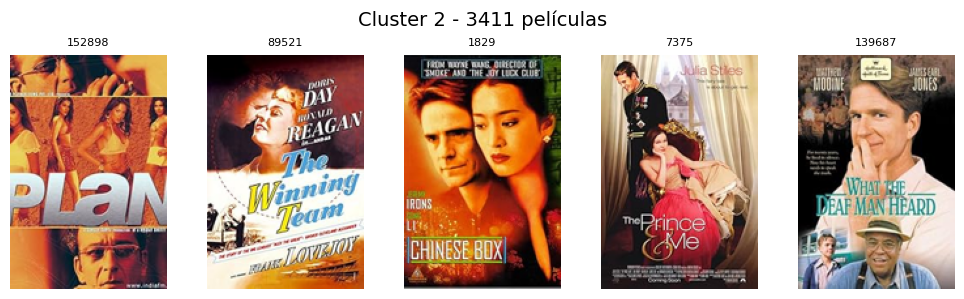

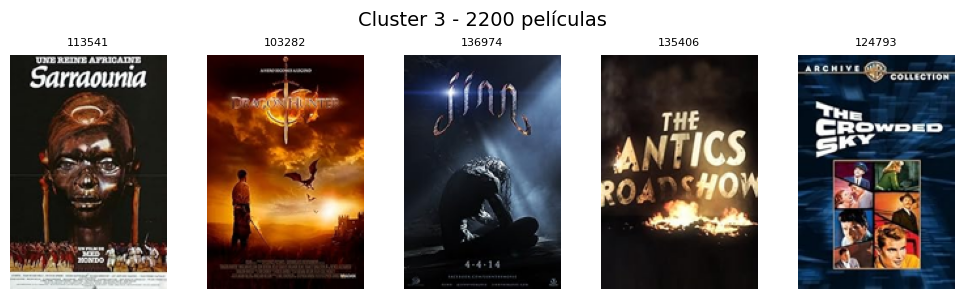

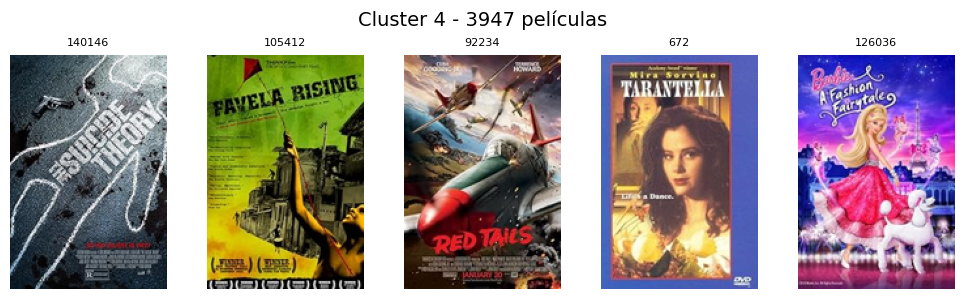

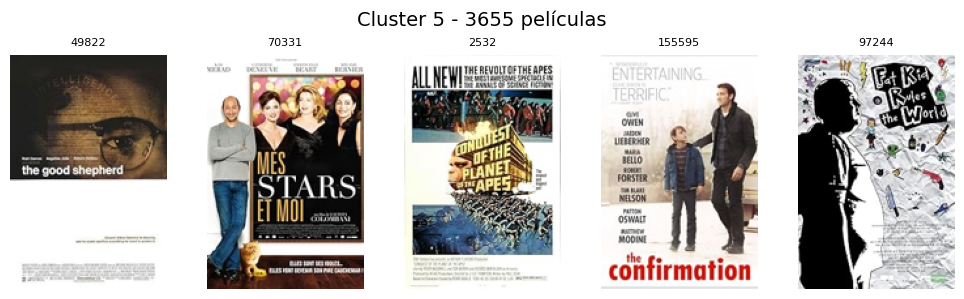

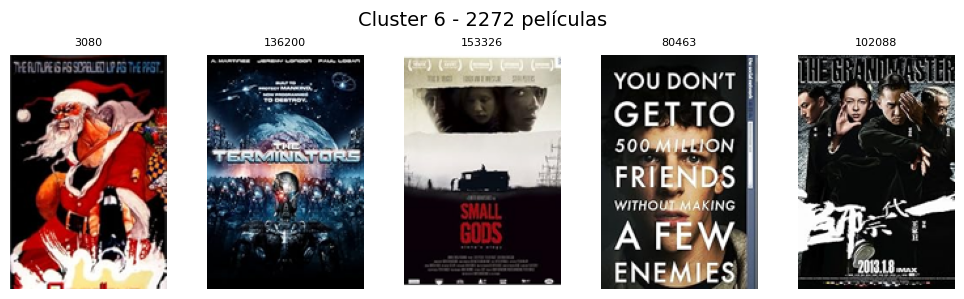

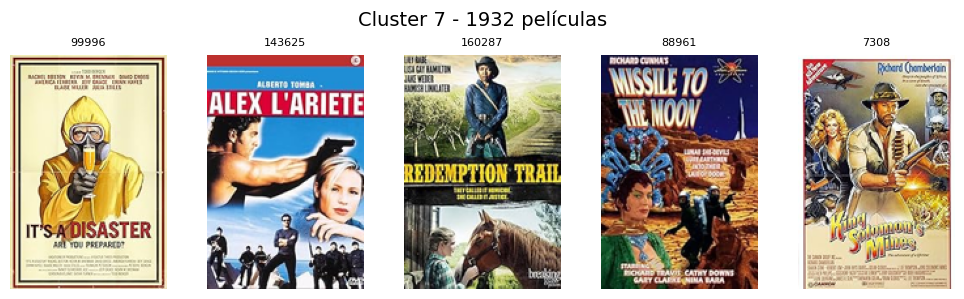

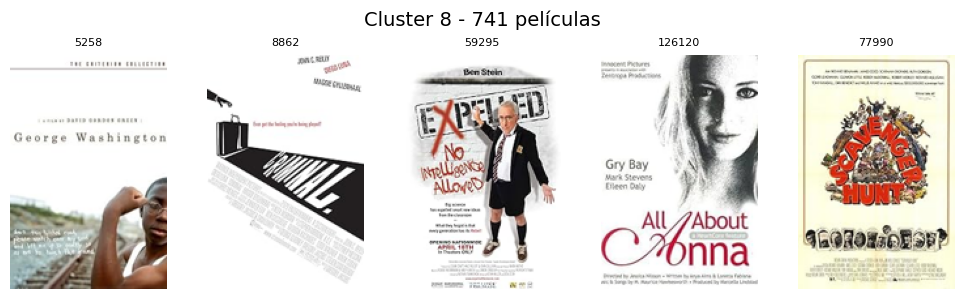

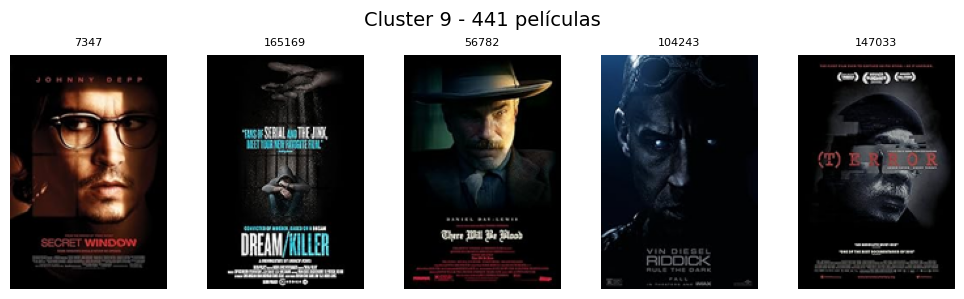

In [ ]:
features, metadata = load_data(
    "features.npy",
    "movies_with_posters.csv",
    "labels_agglomerative_PCA.npy"
)
show_multiple_per_cluster(metadata, posters_dir="data/posters", max_per_cluster=5)

### Usando SVD

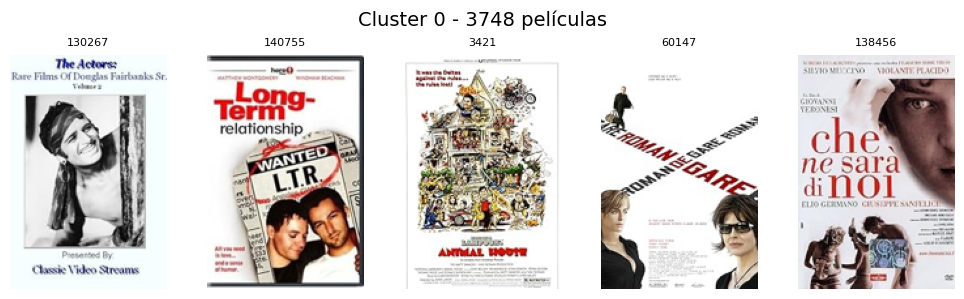

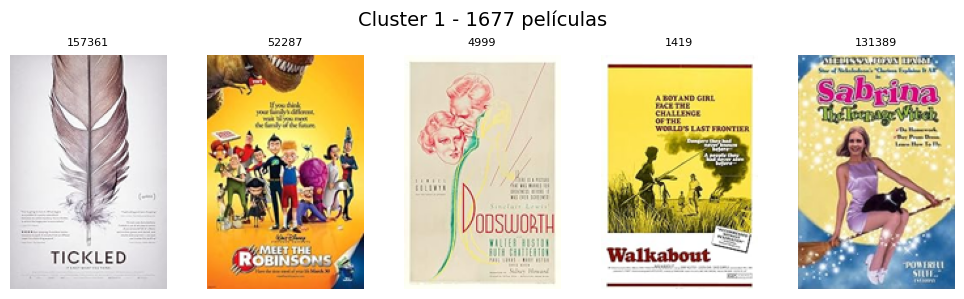

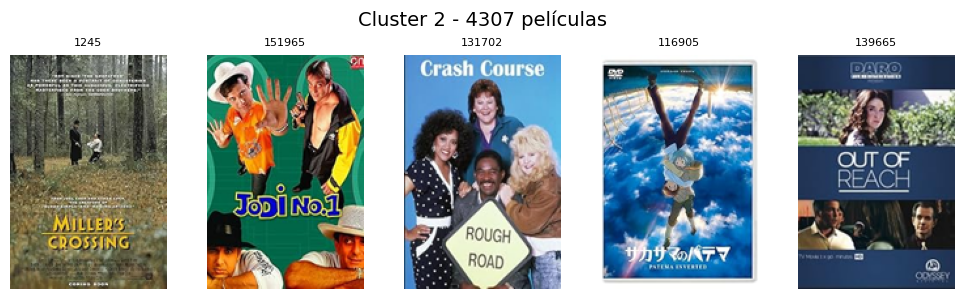

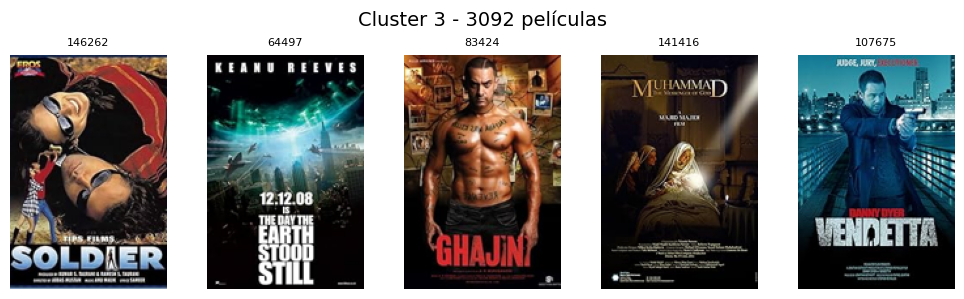

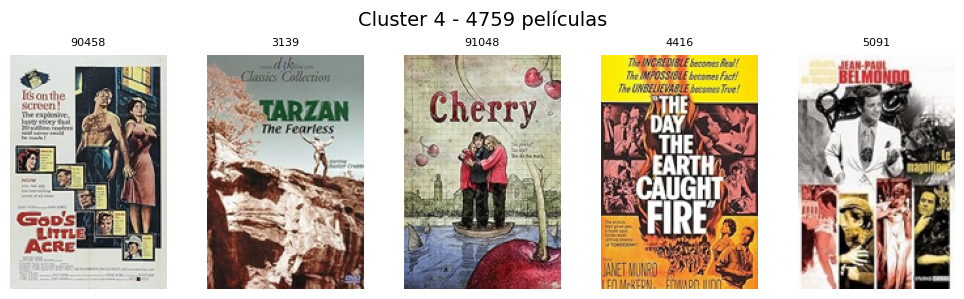

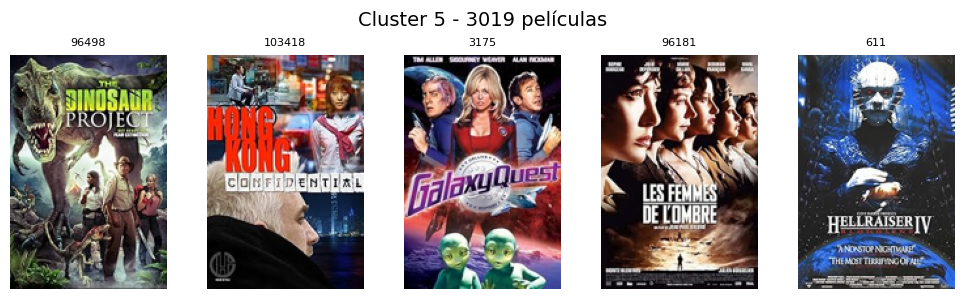

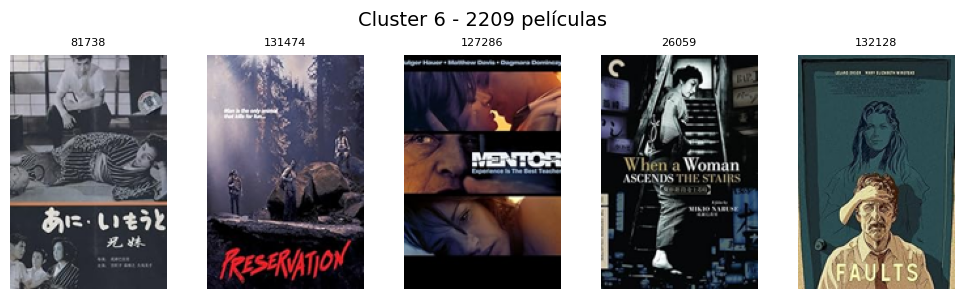

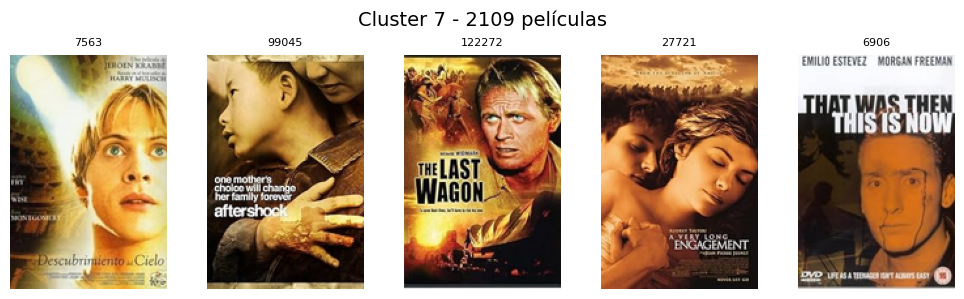

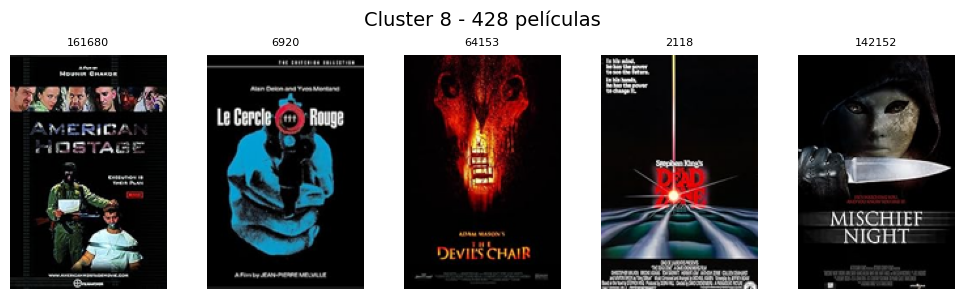

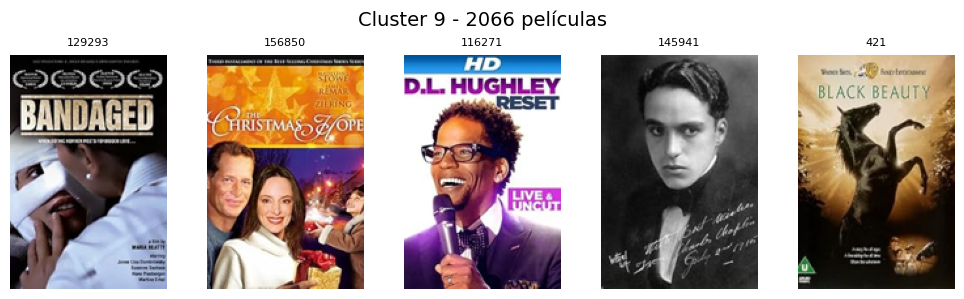

In [ ]:
features, metadata = load_data(
    "features.npy",
    "movies_with_posters.csv",
    "labels_agglomerative_SVD.npy"
)
show_multiple_per_cluster(metadata, posters_dir="data/posters", max_per_cluster=5)

# Recomendaciones

## KMeans PCA

Películas recomendadas para 44972: [np.int64(5094), np.int64(4494), np.int64(136800), np.int64(6888), np.int64(68835), np.int64(161290), np.int64(95572), np.int64(78717), np.int64(59014), np.int64(129233)]


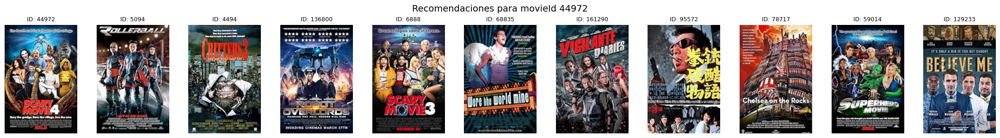

In [ ]:
features, metadata = load_data(
    "features.npy",
    "movies_with_posters.csv",
    "labels_kmeans_PCA.npy"
)
# movie_id =5349
movie_id = 44972
recs = recommend_similar(movie_id, features, metadata, top_k=10)
print(f"Películas recomendadas para {movie_id}: {recs}")
show_recommendations(movie_id, recs, posters_dir="data/posters")


## KMeans SVD

Películas recomendadas para 44972: [np.int64(5094), np.int64(4494), np.int64(136800), np.int64(6888), np.int64(68835), np.int64(161290), np.int64(95572), np.int64(78717), np.int64(59014), np.int64(129233)]


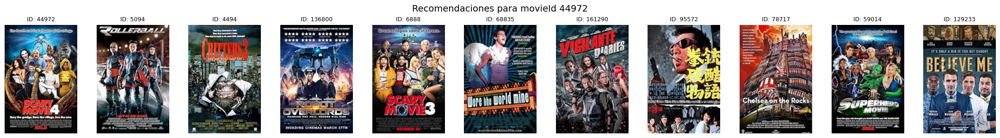

In [ ]:
features, metadata = load_data(
    "features.npy",
    "movies_with_posters.csv",
    "labels_kmeans_SVD.npy"
)
# movie_id =5349
movie_id = 44972
recs = recommend_similar(movie_id, features, metadata, top_k=10)
print(f"Películas recomendadas para {movie_id}: {recs}")
show_recommendations(movie_id, recs, posters_dir="data/posters")


## Agglomerative PCA

Películas recomendadas para 44972: [np.int64(5094), np.int64(6888), np.int64(95572), np.int64(58850), np.int64(161918), np.int64(4580), np.int64(58876), np.int64(51084), np.int64(112705), np.int64(115927)]


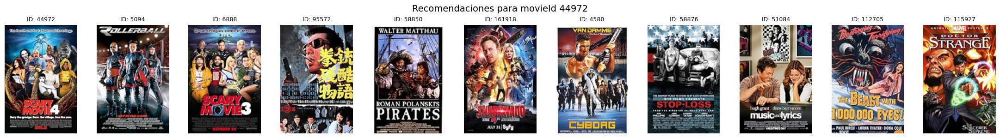

In [ ]:
features, metadata = load_data(
    "features.npy",
    "movies_with_posters.csv",
    "labels_agglomerative_PCA.npy"
)
# movie_id =5349
movie_id = 44972
recs = recommend_similar(movie_id, features, metadata, top_k=10)
print(f"Películas recomendadas para {movie_id}: {recs}")
show_recommendations(movie_id, recs, posters_dir="data/posters")


## Agglomerative SVD

Películas recomendadas para 44972: [np.int64(5094), np.int64(4494), np.int64(6888), np.int64(161290), np.int64(95572), np.int64(78717), np.int64(142921), np.int64(66427), np.int64(149392), np.int64(89002)]


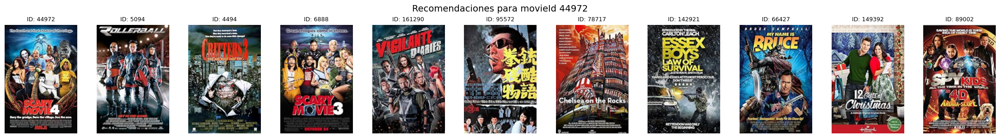

In [ ]:
features, metadata = load_data(
    "features.npy",
    "movies_with_posters.csv",
    "labels_agglomerative_SVD.npy"
)
# movie_id =5349
movie_id = 44972
recs = recommend_similar(movie_id, features, metadata, top_k=10)
print(f"Películas recomendadas para {movie_id}: {recs}")
show_recommendations(movie_id, recs, posters_dir="data/posters")


## Conclusion

- Se pude notar una que ambos modelos de clustering dan resultados similares, con respecto a caracteristicas visuales
- KMeans tiende a crear clusters más compactos, ideal para agrupar posters con estéticas similares
- Para un sistema de recomendaciones en tiempo real, KMeans es mucho más rapido que Agglomerative ya que su algoritmo escala linealmente al numero de datos, en cambio, Agglomerative escala cubicamente
- Se puede notar mayor interpretacion usando PCA, ya que captura mejor las características visuales de las peliculas

La recomendacion que se da es usar KMeans con PCA, ya que ofrece el mejor balance entre precisión, interpretabilidad y eficiencia computacional.

# Sección 06: Evaluación de calidad

## KMeans PCA

In [ ]:
features, metadata = load_data(
    "features.npy",
    "movies_with_posters.csv",
    "labels_kmeans_PCA.npy"
)
metrics = evaluate_internal_metrics(features, metadata["cluster"].values)
print(metrics)

print("Evaluación de consistencia de géneros:")
purity_by_cluster = evaluate_genre_consistency(metadata, genre_column="genres")
for cluster, info in purity_by_cluster.items():
    print(f"Cluster {cluster}: {info['top_genre']} ({info['purity']*100:.1f}% homogéneo)")


Silhouette Score (cosine): 0.1254
{'silhouette': np.float64(0.12537068402590534)}
Evaluación de consistencia de géneros:
Cluster 0: Drama (48.7% homogéneo)
Cluster 1: Drama (49.7% homogéneo)
Cluster 2: Drama (43.0% homogéneo)
Cluster 3: Drama (48.9% homogéneo)
Cluster 4: Drama (45.7% homogéneo)


## KMeans SVD

In [ ]:
features, metadata = load_data(
    "features.npy",
    "movies_with_posters.csv",
    "labels_kmeans_SVD.npy"
)
metrics = evaluate_internal_metrics(features, metadata["cluster"].values)
print(metrics)

print("Evaluación de consistencia de géneros:")
purity_by_cluster = evaluate_genre_consistency(metadata, genre_column="genres")
for cluster, info in purity_by_cluster.items():
    print(f"Cluster {cluster}: {info['top_genre']} ({info['purity']*100:.1f}% homogéneo)")


Silhouette Score (cosine): 0.1253
{'silhouette': np.float64(0.125348986663388)}
Evaluación de consistencia de géneros:
Cluster 0: Drama (48.7% homogéneo)
Cluster 1: Drama (49.6% homogéneo)
Cluster 2: Drama (45.7% homogéneo)
Cluster 3: Drama (49.1% homogéneo)
Cluster 4: Drama (43.0% homogéneo)


## Agglomerative PCA

In [ ]:
features, metadata = load_data(
    "features.npy",
    "movies_with_posters.csv",
    "labels_agglomerative_PCA.npy"
)
metrics = evaluate_internal_metrics(features, metadata["cluster"].values)
print(metrics)

print("Evaluación de consistencia de géneros:")
purity_by_cluster = evaluate_genre_consistency(metadata, genre_column="genres")
for cluster, info in purity_by_cluster.items():
    print(f"Cluster {cluster}: {info['top_genre']} ({info['purity']*100:.1f}% homogéneo)")


Silhouette Score (cosine): 0.0573
{'silhouette': np.float64(0.057283908266859467)}
Evaluación de consistencia de géneros:
Cluster 0: Drama (46.9% homogéneo)
Cluster 1: Drama (48.1% homogéneo)
Cluster 2: Drama (47.0% homogéneo)
Cluster 3: Drama (48.0% homogéneo)
Cluster 4: Drama (45.6% homogéneo)


## Agglomerative SVD

In [ ]:
features, metadata = load_data(
    "features.npy",
    "movies_with_posters.csv",
    "labels_agglomerative_SVD.npy"
)
metrics = evaluate_internal_metrics(features, metadata["cluster"].values)
print(metrics)

print("Evaluación de consistencia de géneros:")
purity_by_cluster = evaluate_genre_consistency(metadata, genre_column="genres")
for cluster, info in purity_by_cluster.items():
    print(f"Cluster {cluster}: {info['top_genre']} ({info['purity']*100:.1f}% homogéneo)")


Silhouette Score (cosine): 0.0559
{'silhouette': np.float64(0.05585808266200561)}
Evaluación de consistencia de géneros:
Cluster 0: Drama (48.2% homogéneo)
Cluster 1: Drama (45.9% homogéneo)
Cluster 2: Drama (46.1% homogéneo)
Cluster 3: Comedy (46.5% homogéneo)
Cluster 4: Drama (49.9% homogéneo)
